# 1) Download Dataset

In [1]:
import gdown
url = "https://drive.google.com/uc?id=1kjmg_a4OhwLU8MjOwPDR1PCPw7b498mj"
output = '../data/dataset.csv'
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1kjmg_a4OhwLU8MjOwPDR1PCPw7b498mj
To: /home/jgoncalves/airc/LoRaWAN-paper-1/data/dataset.csv
100%|██████████| 4.33M/4.33M [00:00<00:00, 15.0MB/s]


'../data/dataset.csv'

## 2) Clean Dataset

In [2]:
import pandas as pd
df = pd.read_csv("../data/dataset.csv")
df.head()

,gw_eui,timestamp_unix_millis,timestamp_utc_iso_string,rssi_dbm,snr_db,distance_to_gw_km,land_or_sea,gw_lon_deg_wgs84,gw_lat_deg_wgs84,dev_lon_deg_wgs84,dev_lat_deg_wgs84
0,7076FF00560705D1,1642250989155,2022-01-15T12:49:49.155Z,-119,-7.2,5.035,land,-27.111835,38.709454,-27.122164,38.754009
1,7076FF00560705D1,1642250989330,2022-01-15T12:49:49.330Z,-99,10.8,3.747,land,-27.111820,38.709488,-27.154640,38.713879
2,7276FF000B031818,1642451839370,2022-01-17T20:37:19.370Z,-112,9.0,3.027,land,-27.225452,38.647633,-27.215952,38.673824
3,7276FF000B03183A,1642451871640,2022-01-17T20:37:51.640Z,-126,-6.5,2.033,land,-27.224787,38.656895,-27.215952,38.673824
4,7276FF000B031818,1642451871645,2022-01-17T20:37:51.645Z,-94,7.5,3.027,land,-27.225450,38.647630,-27.215952,38.673824


In [3]:
# Gw reference
gws = {
  "sta_barbara": "7076FF0056060728",
  "serra_cume": "7076FF00560705D1",
  "altares": "7076FF00560705D7",
  "pico_cruzinhas": "7276FF000B031818",
  "centro_cultural": "7276FF000B03183A",
  "parque_industrial": "7276FF000B03183D",
  "eyecon_office": "7276FF000B031748"
}

# filter dataset to keep only measurements at sea
df_sea = df[df["land_or_sea"] == "sea"]

# dataset length
len(df_sea)


21784

In [4]:
# filter at sea dataset to keep only measurements from sta_barbara gw
df_sea_sta_barbara = df_sea[df_sea["gw_eui"] == gws["sta_barbara"]]
df_sea_sta_barbara.to_csv("../data/sea_sta_barbara_dataset.csv")

# Choose sub-dataset to use

+ All sea events OR
+ Only sea and Santa Bárbara events

In [5]:
# Comment off line as appropriate
#df_analysis = df_sea
# OR
df_analysis = df_sea_sta_barbara

In [6]:
# print stats
total = len(df_analysis)
max_dist = max(df_analysis["distance_to_gw_km"])
print(f"total: {total}, max distance: {max_dist} km", )

total: 12381, max distance: 134.743 km


# 3) Explore Dataset

### 3.1) Distance vs RSSI

<Axes: xlabel='distance_to_gw_km', ylabel='rssi_dbm'>

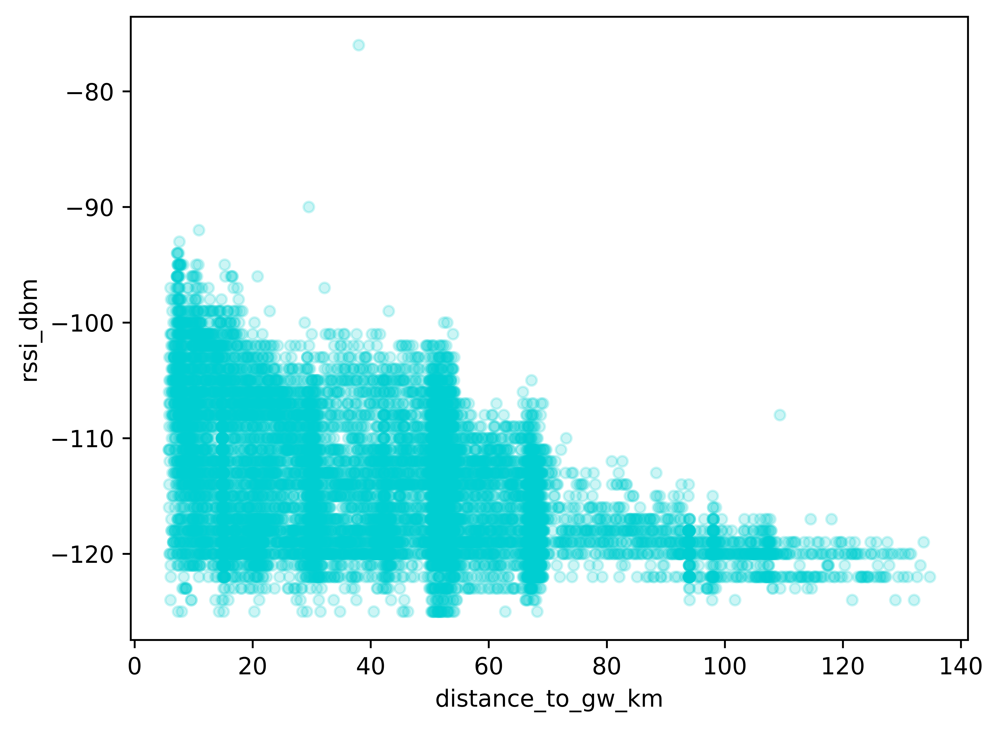

In [7]:
# 1
# x = distance, y = RSSI
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 1200
df_analysis.plot.scatter(x='distance_to_gw_km', y='rssi_dbm', c='darkturquoise', alpha = 0.2)


### 3.2) Distance vs SNR

<Axes: xlabel='distance_to_gw_km', ylabel='snr_db'>

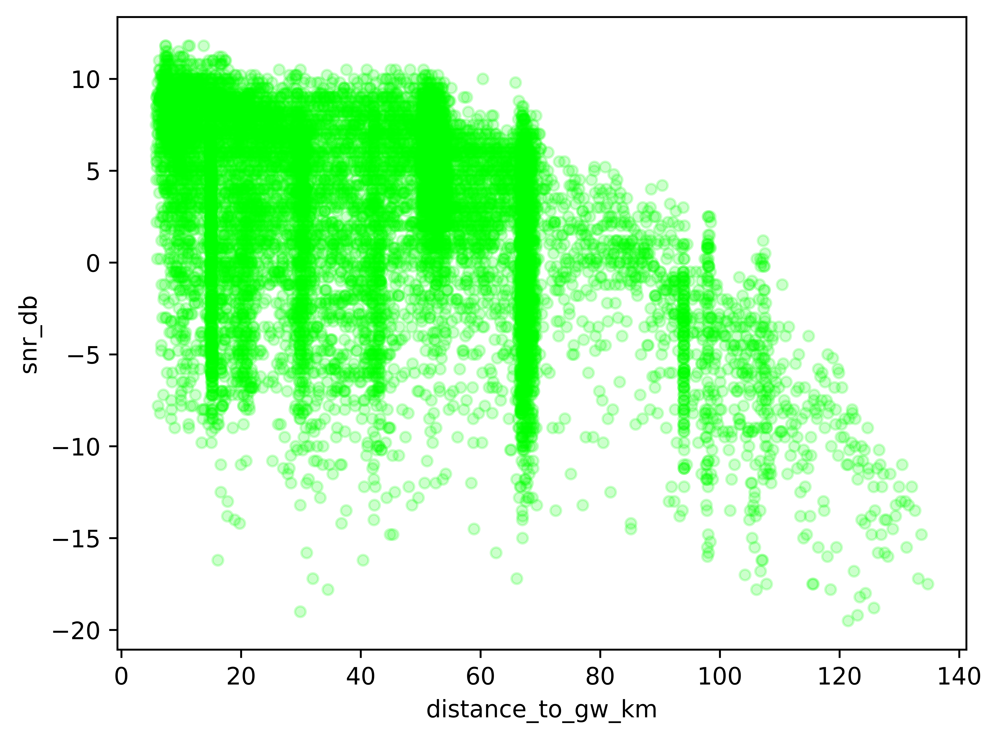

In [8]:
# 2
# x = distance, y = SNR
df_analysis.plot.scatter(x='distance_to_gw_km', y='snr_db', c='lime', alpha = 0.2)

### 3.3) RSSI vs SNR

<Axes: xlabel='rssi_dbm', ylabel='snr_db'>

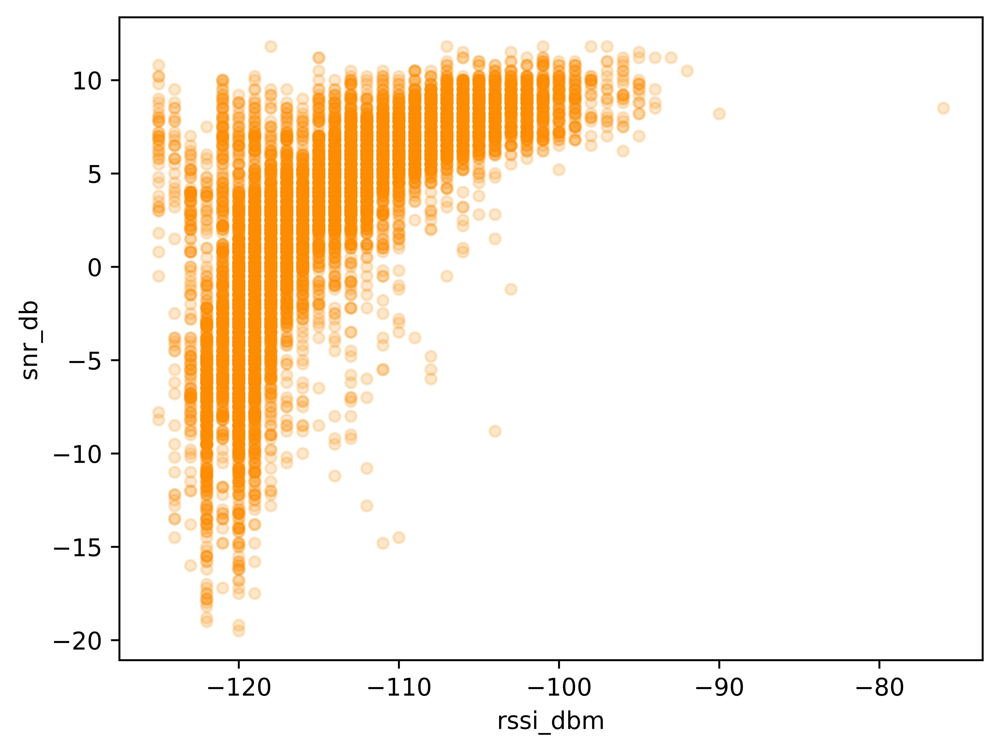

In [9]:
# 3
# x = RSSI, y = SNR
df_analysis.plot.scatter(x='rssi_dbm', y='snr_db', c='darkorange', alpha = 0.2)


### 3.4) Location

Thanks you### SNR
I'm no expert on this, obviously, but it seems that most analysis of the NSR (how it stands with respect to RSSI) are made overtime. In our case, this is not straightforward since we are analysing a moving target.

**André e João**, should we add something like a traditional NSR analysis?

**João**, I believe that we could achieve that by identifying 2-3 places where we have a high density of readings. See (geographically innacurate but enough to make this point) plot Location below.

+ 2-3 places at different distances, say 10km, 60km and 100km?
+ a "place" could have a radius of 2km?, for example.
+ from plot 4, it seems that the top right corner has a good candidate to a "place" at long distance.
+ for each candidate location, we measure the varience of the RSSI, and if small, it validates the asusmption that we could use this to have a look at how the SNR fairs in relation to the RSSI baseline (mean value, given a small variance).
  + if variance is high, perhaps we should try a smaller radius. probably worth it to play a bit with this to figure out a reasonable compromise.

What do you think?


<Axes: xlabel='dev_lon_deg_wgs84', ylabel='dev_lat_deg_wgs84'>

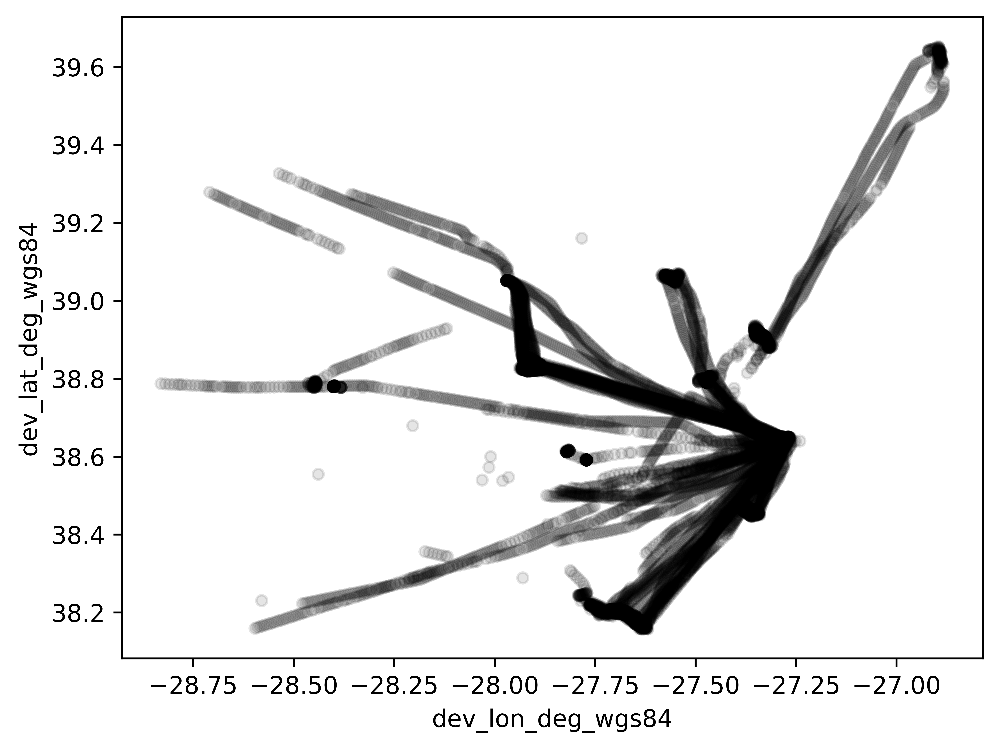

In [10]:
# 4
# x = long, y = lat
df_analysis.plot.scatter(x='dev_lon_deg_wgs84', y='dev_lat_deg_wgs84', c='black', alpha = 0.1)

###ipyleaflet
docs https://ipyleaflet.readthedocs.io/

uncomment below and run to install ipyleaflet in google colab env

In [11]:
#!pip install ipyleaflet

the idea is to draw a 2km circle using the interactive map and select only the points within

In [12]:
from ipyleaflet import Map, basemaps, basemap_to_tiles, Heatmap, DrawControl, Circle
from ipywidgets import Layout

# create a map interface centered on Terceira Island
m = Map(
    basemap=basemap_to_tiles(basemaps.OpenStreetMap.Mapnik),
    center=(38.89302228605274, -27.202870445670907),
    zoom=9.8,
    layout=Layout(width='1920px', height='1080px')
    )

# add draw controls to map
draw_control = DrawControl()
draw_control.circle = {
  "shapeOptions": {
      "fillColor": "#efed69",
      "color": "#efed69",
      "fillOpacity": 1.0
  }
}

# this function is called after something is drawn on the map
def callback(self, action, geo_json):
  print(action, geo_json)
  if action == "created":
    # add a circle to the map
    circle = Circle()
    circle.location = (geo_json["geometry"]["coordinates"][1],geo_json["geometry"]["coordinates"][0])
    circle.radius = int(geo_json["properties"]["style"]["radius"])
    circle.color = "green"
    circle.fill_color = "green"
    draw_control.clear()
    m.add_layer(circle)

draw_control.on_draw(callback)
m.add_control(draw_control)

# heatmap of the events
lons = list(df_analysis["dev_lon_deg_wgs84"])
lats = list(df_analysis["dev_lat_deg_wgs84"])

heatmap = Heatmap(
    locations=[[lats[i], lons[i]] for i in range(len(lats))],
    radius=15
)
m.add_layer(heatmap)

# add the 12 selected areas to the map for reference
def add_circle(location, radius, color):
  circle = Circle()
  circle.location = location
  circle.radius = radius
  circle.color = color
  circle.fill_color = color
  m.add_layer(circle)

circle_center_point_by_color = {
    "red": (39.620395, -26.90367),
    "green": (38.204023, -27.701205),
    "blue": (38.834382, -27.907589),
    "yellow": (39.044477, -27.548558),
    "orange": (38.800204, -27.459609),
    "purple": (38.458097, -27.347993),
    "pink": (38.910218, -27.337965),
    "brown": (38.633978, -27.274188),
    "gray": (38.165462, -28.571266),
    "black": (38.782374, -28.430655),
    "white": (39.257761, -28.666294),
    "cyan": (38.788358, -28.796452)
}

circle_radius = 3000

# add colored circles to map
for color in circle_center_point_by_color:
  add_circle(circle_center_point_by_color[color], circle_radius, color)

m

Map(center=[38.89302228605274, -27.202870445670907], controls=(ZoomControl(options=['position', 'zoom_in_text'…

## Potential Areas (circles) of interest.

*   Item de lista
*   Item de lista



##### Map of Selected Areas
<img src="https://drive.google.com/uc?export=view&id=1zqdIigQEiVdvEjQ43dx1vF7czlYX3ry4" alt="Selected Areas"/>
Figure 1- 4km radius circles based on visual judgement of distance and density (assisted by the desnity map).

##### Coordinates of the centers of the circles of the 12 areas selected
[-26.90367, 39.620395]<br>
[-27.701205, 38.204023]<br>
[-27.907589, 38.834382]<br>
[-27.548558, 39.044477]<br>
[-27.459609, 38.800204]<br>
[-27.347993, 38.458097]<br>
[-27.337965, 38.910218]<br>
[-27.274188, 38.633978]<br>
[-28.571266, 38.165462]<br>
[-28.430655, 38.782374]<br>
[-28.666294, 39.257761]<br>
[-28.796452, 38.788358]<br>

#### Notes about the circles (in the same order as above)
##### 1- Furthest (North)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-26.90367, 39.620395]}}

##### 2- Far (South) - GREEN
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-27.701205, 38.204023]}}

##### 3- Mediuam distance (West) (highest density)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-27.907589, 38.834382]}}

##### 4- Mediuam distance (North)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-27.548558, 39.044477]}}

##### 5- Mediuam distance (Northwest)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-27.459609, 38.800204]}}

##### 6- Medium low distance (South)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-27.347993, 38.458097]}}

##### 7- Medium low distance (North)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-27.337965, 38.910218]}}

##### 8- Closest (South, by Sao Mateus Port)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-27.274188, 38.633978]}}

##### 9- Far South (low density)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-28.571266, 38.165462]}}

##### 10- Farthest? West (low density)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-28.430655, 38.782374]}}

##### 11- Far West (low density)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-28.666294, 39.257761]}}

##### 12- Far West (low density)
>created {'type': 'Feature', 'properties': {'style': {'stroke': True, 'color': '#efed69', 'weight': 4, 'opacity': 0.5, 'fill': True, 'fillColor': '#efed69', 'fillOpacity': 1, 'clickable': True, 'radius': 4000.000000000000}}, 'geometry': {'type': 'Point', 'coordinates': [-28.796452, 38.788358]}}





In [14]:
# subset by area of interest
from geopy import distance

def point_is_within_circle(point, circle_center, circle_radius_m):
  dist = distance.distance(point, circle_center).m
  return dist < circle_radius_m

# the subsets go here
df_subset_by_color = {}

# makes the subsets and adds them to 'df_subset_by_color' dictionary
for color in circle_center_point_by_color:
  def filter_fn(row):
    point = (row["dev_lat_deg_wgs84"], row["dev_lon_deg_wgs84"])
    return point_is_within_circle(point, circle_center_point_by_color[color], circle_radius)
  df_subset_by_color[color] = df_analysis[df_analysis.apply(filter_fn, axis=1)]

# Important! - we should verify all the subsets to make sure


In [15]:
# add subsets to a map for verification
m = Map(
    basemap=basemap_to_tiles(basemaps.OpenStreetMap.Mapnik),
    center=(38.89302228605274, -27.202870445670907),
    zoom=11,
    layout=Layout(width='6895px', height='5189px')
  )

def add_subset_to_map(df):
  # heatmap of the events
  lons = list(df["dev_lon_deg_wgs84"])
  lats = list(df["dev_lat_deg_wgs84"])

  heatmap = Heatmap(
      locations=[[lats[i], lons[i]] for i in range(len(lats))],
      radius=15
  )
  m.add_layer(heatmap)

# add a subsets to the map. change color key to veryfy the other subsets
#add_subset_to_map(df_subset_by_color["green"])

# add all subsets to map for verification
for color in circle_center_point_by_color:
  add_circle(circle_center_point_by_color[color], circle_radius, color)
  add_subset_to_map(df_subset_by_color[color])

m

Map(center=[38.89302228605274, -27.202870445670907], controls=(ZoomControl(options=['position', 'zoom_in_text'…

In [16]:
# print subset stats
import statistics
def print_stats_for(color):
  print(f"## {color} subset stats:")
  count = len(df_subset_by_color[color])
  print(f"Point count: {count}")
  mean_distance_to_gw = statistics.mean(df_subset_by_color[color]["distance_to_gw_km"])
  print(f"Mean Distance to Gw: {mean_distance_to_gw}")
  mean_rssi = statistics.mean(df_subset_by_color[color]["rssi_dbm"])
  print(f"Mean RSSI: {mean_rssi}")
  mean_snr = statistics.mean(df_subset_by_color[color]["snr_db"])
  print(f"Mean SNR: {mean_snr}\n")
  # TODO - other stats


for color in circle_center_point_by_color:
  print_stats_for(color)


## red subset stats:
Point count: 101
Mean Distance to Gw: 106.28872277227723
Mean RSSI: -120.05940594059406
Mean SNR: -7.370297029702971

## green subset stats:
Point count: 715
Mean Distance to Gw: 67.25571608391608
Mean RSSI: -117.1006993006993
Mean SNR: 0.20937062937062936

## blue subset stats:
Point count: 1654
Mean Distance to Gw: 52.08262031438936
Mean RSSI: -113.33736396614269
Mean SNR: 5.250544135429262

## yellow subset stats:
Point count: 206
Mean Distance to Gw: 41.81626699029126
Mean RSSI: -117.99029126213593
Mean SNR: -1.6320388349514563

## orange subset stats:
Point count: 657
Mean Distance to Gw: 14.993031963470319
Mean RSSI: -115.8751902587519
Mean SNR: 1.1902587519025876

## purple subset stats:
Point count: 475
Mean Distance to Gw: 30.209943157894738
Mean RSSI: -115.42315789473685
Mean SNR: 1.6233684210526316

## pink subset stats:
Point count: 307
Mean Distance to Gw: 20.388263843648208
Mean RSSI: -118.36807817589576
Mean SNR: -1.0485342019543973

## brown subset 

In [17]:
# fill distance and metrics arrays for the plots
distances = []
rssi_values = []
snr_values = []

for color in circle_center_point_by_color:
  distances.append(statistics.mean(df_subset_by_color[color]["distance_to_gw_km"]))
  rssi_values.append(statistics.mean(df_subset_by_color[color]["rssi_dbm"]))
  snr_values.append(statistics.mean(df_subset_by_color[color]["snr_db"]))


# 4) Plots for Publication

### 4.1) RSSI as Function of Distance

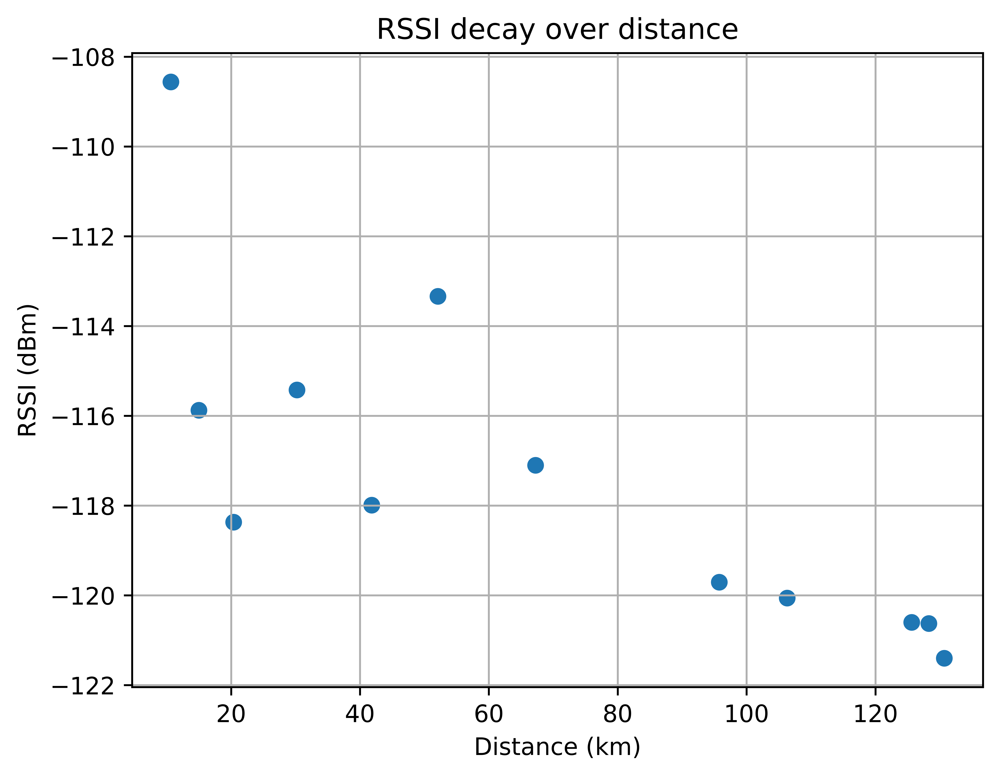

In [18]:
#Plot title: Received Signal Strength Indicator decay over Distance?

import matplotlib.pyplot as plt

# Use matplotlib to plot the RSSI decay over distance
plt.scatter(distances, rssi_values)

# Add labels to the axes and a title to the plot
plt.xlabel('Distance (km)')
plt.ylabel('RSSI (dBm)')
plt.title('RSSI decay over distance')

# Turn on the grid
plt.grid(True)

# Show the plot
plt.show()



